In [1]:
import os
import glob
import cv2
import imageio
%matplotlib inline
import numpy as np
import pandas as pd
import nibabel as nib
import matplotlib.pyplot as plt

from tqdm.notebook import tqdm
from ipywidgets import *
from PIL import Image
from matplotlib.pyplot import figure

from fastai.basics import *
from fastai.vision.all import *
from fastai.data.transforms import *

In [3]:
fli = []
sf = []
for dirname, _, fnames in os.walk('data'):
    #print(fnames)
    for fn in fnames :
        if 'segmentation' in fn:
            sf.append((dirname,fn))
        else:
            
            fli.append((dirname,fn))
        


df_image = pd.DataFrame(fli,columns = ['dir_in','fname']) 
df_seg = pd.DataFrame(sf,columns = ['dir_seg','fname_seg'])

print(df_image)


              dir_in           fname
0    data\case_00000  imaging.nii.gz
1    data\case_00001  imaging.nii.gz
2    data\case_00002  imaging.nii.gz
3    data\case_00003  imaging.nii.gz
4    data\case_00004  imaging.nii.gz
..               ...             ...
295  data\case_00295  imaging.nii.gz
296  data\case_00296  imaging.nii.gz
297  data\case_00297  imaging.nii.gz
298  data\case_00298  imaging.nii.gz
299  data\case_00299  imaging.nii.gz

[300 rows x 2 columns]


In [4]:
df = [df_image,df_seg]
final_df = pd.concat([df_image,df_seg],axis=1)

In [5]:
final_df.head()

,dir_in,fname,dir_seg,fname_seg
0,data\case_00000,imaging.nii.gz,data\case_00000,segmentation.nii.gz
1,data\case_00001,imaging.nii.gz,data\case_00001,segmentation.nii.gz
2,data\case_00002,imaging.nii.gz,data\case_00002,segmentation.nii.gz
3,data\case_00003,imaging.nii.gz,data\case_00003,segmentation.nii.gz
4,data\case_00004,imaging.nii.gz,data\case_00004,segmentation.nii.gz


In [6]:
def read_nii(fp):
    ct_scan = nib.load(fp)
    arr = ct_scan.get_fdata()
    arr = np.rot90(np.array(arr),k=1,axes=(0,2))
    return (arr)

In [7]:
sample =13

sample_ct = read_nii(final_df.loc[sample,'dir_in']+"/"+final_df.loc[sample,'fname'])
sample_mask = read_nii(final_df.loc[sample,'dir_seg']+"/"+final_df.loc[sample,'fname_seg'])
print(f'CT Shape:  {sample_ct.shape}\nMask Shape: {sample_mask.shape}')

CT Shape:  (512, 512, 92)
Mask Shape: (512, 512, 92)


In [8]:
def vis_im(array_):
    array = np.rot90(np.array(array_),k=-1)
    return(array)

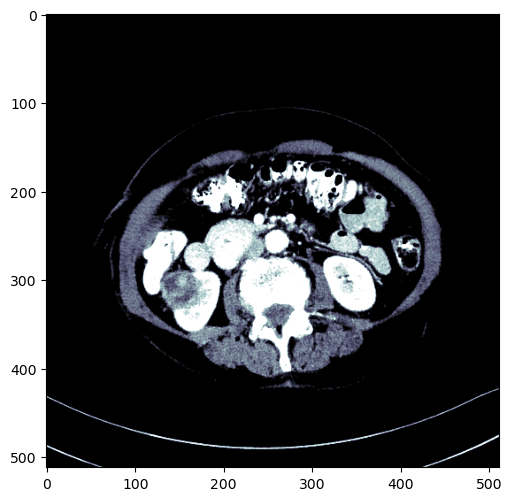

In [9]:
dicom_windows = types.SimpleNamespace(
    brain=(80,40),
    subdural=(254,100),
    stroke=(8,32),
    brain_bone=(2800,600),
    brain_soft=(375,40),
    lungs=(1500,-600),
    mediastinum=(350,50),
    abdomen_soft=(400,50),
    liver=(150,30),
    spine_soft=(250,50),
    spine_bone=(1800,400),
    custom=(200,60)
)

@patch
def windowed(self:Tensor,w,l):
    px=self.clone()
    px_min=l-w//2
    px_max=l+w//2
    px[px<px_min]=px_min
    px[px>px_max]=px_max
    return (px-px_min) / (px_max-px_min)
figure(figsize=(8,6),dpi=100)
plt.imshow(tensor(vis_im(sample_ct[...,45]).astype(np.float32)).windowed(*dicom_windows.custom),cmap=plt.cm.bone);
plt.show()
    

In [10]:
def plot_sample(array_list,color_map='nipy_spectral'):
    fig=plt.figure(figsize=(20,16),dpi=100)
    
    plt.subplot(1,4,1)
    plt.imshow(array_list[0],cmap='bone')
    plt.title('Original Image')
    plt.axis('off')
    
    plt.subplot(1,4,2)
    plt.imshow(tensor(array_list[0].astype(np.float32)).windowed(*dicom_windows.custom),cmap='bone');
    plt.title('Windowed Image')
    plt.axis('off')
  
     
    plt.subplot(1,4,3) 
    plt.imshow(array_list[1],alpha=0.5,cmap=color_map)
    plt.title('Mask')
    plt.axis('off')
    
    plt.subplot(1,4,4)
    plt.imshow(array_list[0],cmap='bone')
    plt.imshow(array_list[1],alpha=0.5,cmap=color_map)
    plt.title('KId & Mask')
    plt.axis('off')

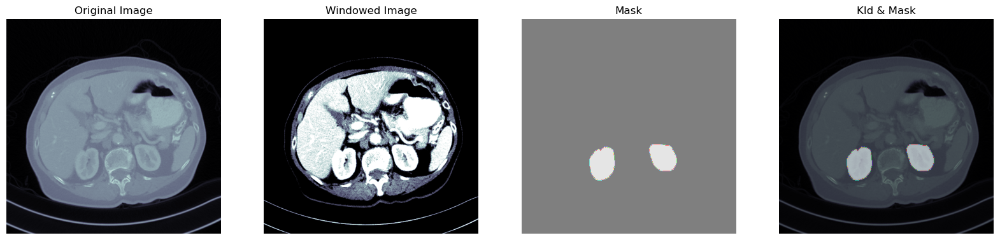

In [11]:
sample = 25

sample_slice = tensor(vis_im(sample_ct[...,sample]).astype(np.float32))
plot_sample([vis_im(sample_ct[...,sample]),
             vis_im(sample_mask[...,sample])])

In [12]:
sample_slice.contiguous().view(-1)

tensor([ -994.,  -995.,  -984.,  ..., -1023., -1024., -1023.])

In [13]:
mask = Image.fromarray(sample_mask[...,sample].astype('uint8'),mode="L")
unique,counts=np.unique(mask,return_counts=True)
print(np.array((unique,counts)).T)

[[     0 254997]
 [     1   7147]]


In [14]:
class TensorCTScan (TensorImageBW): _show_args = {'cap': "bone"}

@patch

def freqhist_bins (self: Tensor, n_bins=100):

    #"A function to split the range of pixel values into groups, such that 
    imsd= self.contiguous().view(-1).sort()[0]
    t = torch.cat([tensor([0.001]),
                 torch.arange(n_bins).float()/n_bins+(1/2/n_bins),
                 tensor([0.999])])
    t = (len(imsd)*t).long()
    return imsd[t].unique()

@patch

def hist_scaled(self:Tensor, brks=None):
    "Scales a tensor using freqhist bins to values between 0 and 1"
    if self.device.type=='cuda': return self.hist_scaled_pt(brks)
    if brks is None: brks = self.freqhist_bins()
    ys=np.linspace(0., 1., len(brks))
    x= self.numpy().flatten()
    x=np.interp(x,brks.numpy(),ys)
    return tensor(x).reshape(self.shape).clamp(0.,1.)
@patch
def to_nchan(x:Tensor , wins, bins=None):
    res = [x.windowed(*win) for win in wins]
    if not isinstance(bins,int) or bins!=0: res.append(x.hist_scaled().clamp(0,1))
    dim = [0,1][x.dim()==3]
    return TensorCTScan(torch.stack(res,dim=dim))
@patch
def save_jpg(x:(Tensor),path,wins,bins=None,quality=90):
    fn = Path(path).with_suffix('.jpg')
    x = (x.to_nchan(wins)*255).byte()
    im  = Image.fromarray(x.permute(1,2,0).numpy(),mode=['RGB','CMYK'][x.shape[0]==4])
    im.save(fn,quality=quality)
    
sample_slice.save_jpg('test.jpg',[dicom_windows.liver,dicom_windows.custom])

In [15]:
sample_slice.contiguous().view(-1)

tensor([ -994.,  -995.,  -984.,  ..., -1023., -1024., -1023.])

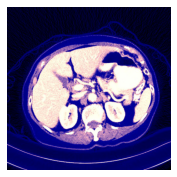

In [16]:
_,axs=subplots(1,1)

sample_slice.save_jpg('test.jpg',[dicom_windows.liver,dicom_windows.custom])
show_image(Image.open('test.jpg'),ax=axs[0])
show_image(Image.open('test.jpg'),ax=axs[0])
plt.show()

In [18]:
GENERATE_JPG_FILES=True

path=Path(".")

os.makedirs('train_images',exist_ok=True)
os.makedirs('train_masks',exist_ok=True)

for ii in tqdm(range(0,len(final_df),3)):
    curr_ct=read_nii(final_df.loc[sample,'dir_in']+"/"+final_df.loc[sample,'fname'])
    curr_mask=read_nii(final_df.loc[sample,'dir_seg']+"/"+final_df.loc[sample,'fname_seg'])
    curr_file_name=str(final_df.loc[ii,'fname']).split('.')[0]
    curr_dim=curr_ct.shape[2]
    
    for curr_slice in range(0,curr_dim,2):
        data=tensor(vis_im(curr_ct[...,curr_slice]).astype(np.float32))
        mask = Image.fromarray(vis_im(curr_mask[...,curr_slice]).astype('uint8'),mode="L")
        data.save_jpg(f"train_images/{curr_file_name}slice{curr_slice}.jpg",[dicom_windows.liver,dicom_windows.custom]
                     )
        mask.save(f"train_masks/{curr_file_name}slice{curr_slice}_mask.png")

  0%|          | 0/100 [00:00<?, ?it/s]

In [19]:
BATCH_SIZE=2
IMAGE_SIZE=512

codes=np.array(["background","kidney","tumor"])

def get_x(fname:Path) : return fname
def label_func(x): return path/'train_masks'/f'{x.stem}_mask.png'

tfms = [IntToFloatTensor(),Normalize()]

db=DataBlock(blocks=(ImageBlock(),MaskBlock(codes)),
             batch_tfms=tfms,
             splitter=RandomSplitter(),
             item_tfms=[Resize(IMAGE_SIZE)],
             get_items=get_image_files,
             get_y=label_func)

ds=db.datasets(source=path/'train_images')

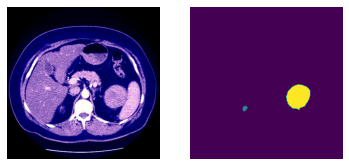

In [20]:
idx=20
imgs=[ds[idx][0],ds[idx][1]]
fig,axs=plt.subplots(1,2)
 
for i,ax in enumerate(axs.flatten()):
    ax.axis("off")
    ax.imshow((imgs[i]))

In [21]:
np.unique(array(ds[idx][1]))

array([0, 1, 2], dtype=uint8)

In [22]:
unique,counts=np.unique(array(ds[idx][1]),return_counts=True)
print(np.array((unique,counts)).T)

[[     0 256915]
 [     1    201]
 [     2   5028]]


Due to IPython and Windows limitation, python multiprocessing isn't available now.
So `number_workers` is changed to 0 to avoid getting stuck


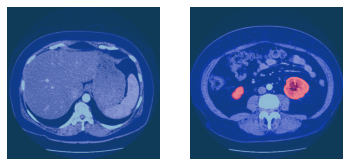

In [23]:
dls=db.dataloaders(path/'train_images',bs=BATCH_SIZE)
dls.show_batch()

In [22]:
from torchsummary import summary

In [23]:
learn=unet_learner(dls,squeezenet1_1,loss_func=CrossEntropyLossFlat(axis=1),metrics=[DiceMulti(axis=1)])

C:\Users\saich\anaconda3\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
C:\Users\saich\anaconda3\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=SqueezeNet1_1_Weights.IMAGENET1K_V1`. You can also use `weights=SqueezeNet1_1_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [24]:
learn.fine_tune(5,wd=0.1,cbs=SaveModelCallback())

epoch,train_loss,valid_loss,dice_multi,time
0,0.117024,0.046272,0.858023,41:42


Better model found at epoch 0 with valid_loss value: 0.046271611005067825.


epoch,train_loss,valid_loss,dice_multi,time
0,0.014465,0.013511,0.943626,44:32
1,0.024302,0.036575,0.848023,1:00:30
2,0.014034,0.007459,0.963995,39:04
3,0.007342,0.005232,0.972922,39:12
4,0.004329,0.004913,0.975872,39:14


Better model found at epoch 0 with valid_loss value: 0.01351060252636671.
Better model found at epoch 2 with valid_loss value: 0.007458597421646118.
Better model found at epoch 3 with valid_loss value: 0.005231715273112059.
Better model found at epoch 4 with valid_loss value: 0.00491314847022295.


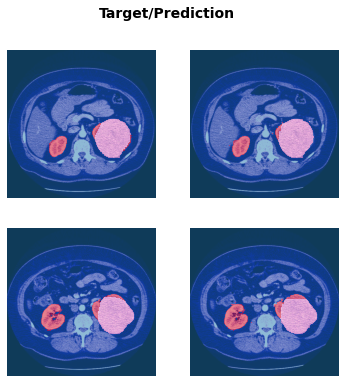

In [25]:
learn.show_results()

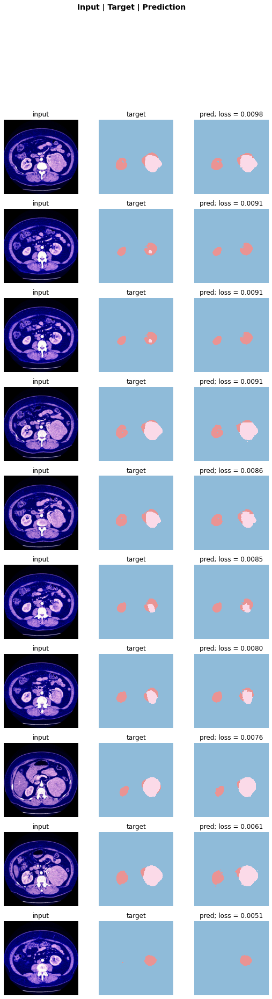

In [26]:
interp=SegmentationInterpretation.from_learner(learn)
interp.plot_top_losses(k=10)

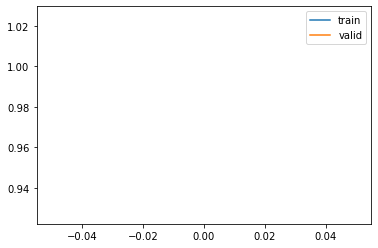

In [44]:
learn.recorder.plot_loss(skip_start=0, with_valid=True)

In [28]:
learn.export(path/f'sqe_segmentation')

In [42]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(title='Confusion matrix')

AttributeError: vocab

In [45]:
learn.recorder.plot_metrics()

AttributeError: 'DynamicUnet' object has no attribute 'plot_metrics'

In [24]:
GENERATE_JPG_FILES = True
if (GENERATE_JPG_FILES):
    
    tfms=[Resize(IMAGE_SIZE),IntToFloatTensor(),Normalize()]
    learn0=load_learner(path/f'KI_segmentation',cpu=False)
    learn0.dls.transform=tfms

In [25]:
a = [0.0144,0.0243,0.0140,0.0073,0.0043]
b = [0.0135,0.0365,0.0074,0.0052,0.0049]
c = [0,1,2,3,4]


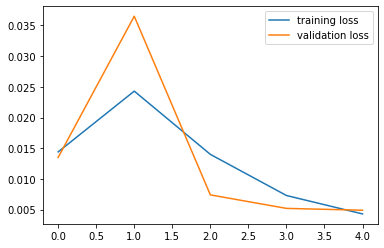

In [28]:


plt.plot(c, a, label = "training loss")
plt.plot(c, b, label = "validation loss")
plt.legend()
plt.show()

In [47]:
print(a)

In [23]:
def nii_tfm(fn,wins):
    
    test_nii=read_nii(fn)
    curr_dim=test_nii.shape[2]
    slices=[]
    
    for curr_slice in range(curr_dim):
        data=tensor(test_nii[...,curr_slice].astype(np.float32))
        data=(data.to_nchan(wins)*255).byte()
        slices.append(TensorImage(data))
        
    return slices

(512, 512, 96)


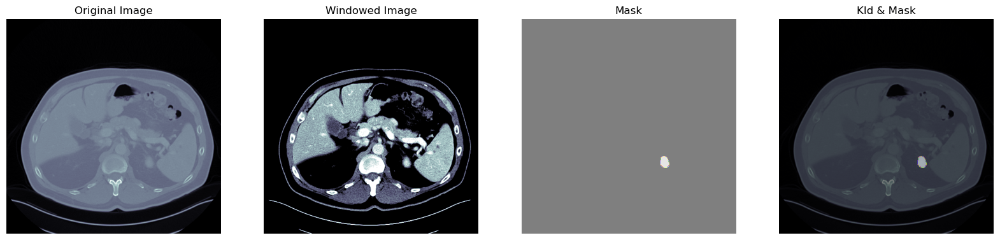

In [24]:
tst=20
 
test_nii=read_nii(final_df.loc[tst,'dir_in']+"/"+final_df.loc[tst,'fname'])
test_mask=read_nii(final_df.loc[tst,'dir_seg']+"/"+final_df.loc[tst,'fname_seg'])
print(test_nii.shape)

test_slice_idx=20

sample_slice=tensor(vis_im(test_nii[...,test_slice_idx]).astype(np.float32))

plot_sample([vis_im(test_nii[...,test_slice_idx]),vis_im(test_mask[...,test_slice_idx])])

<ipython-input-10-091d9eda4021>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig=plt.figure(figsize=(20,16),dpi=100)


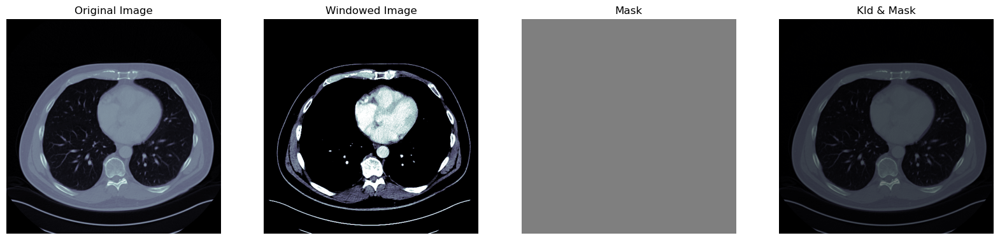

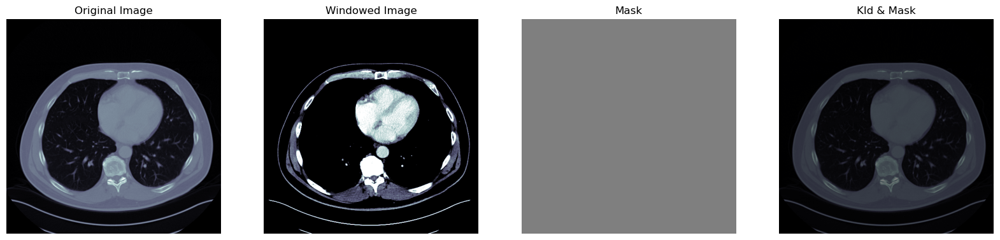

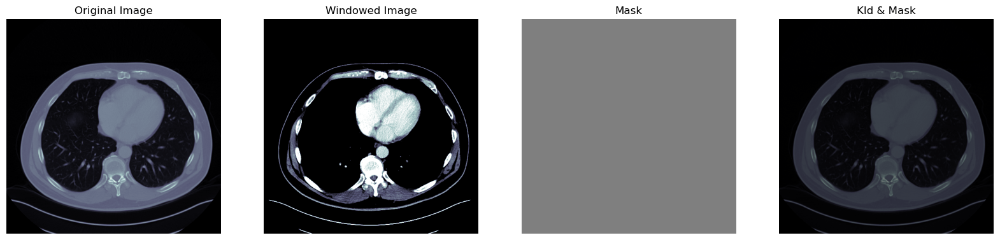

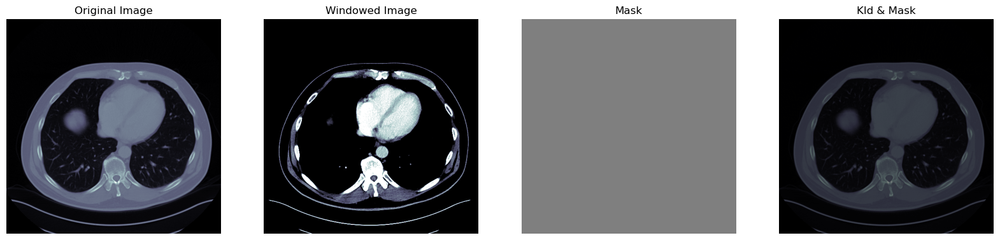

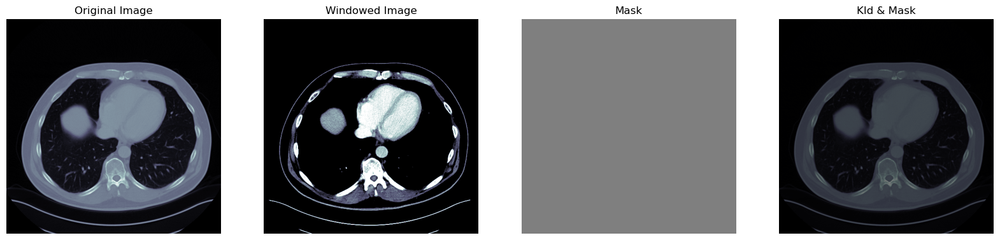

...

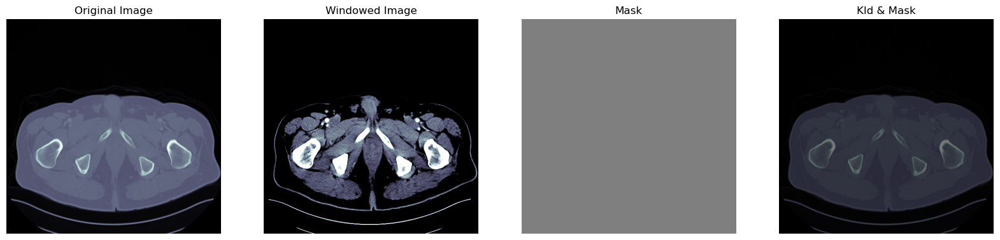

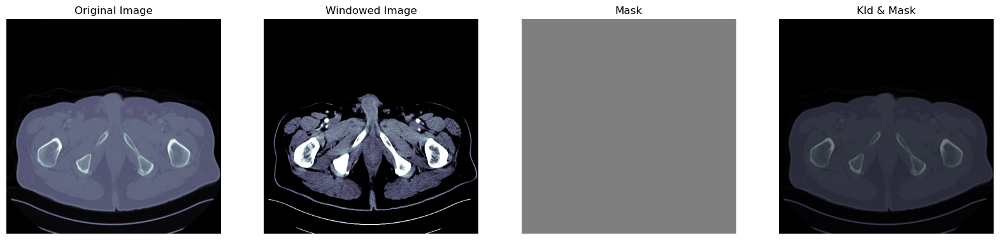

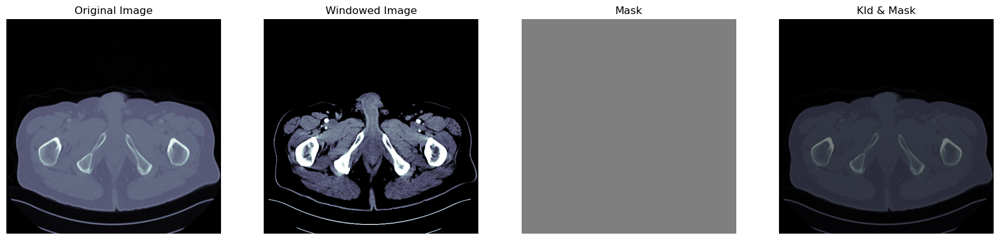

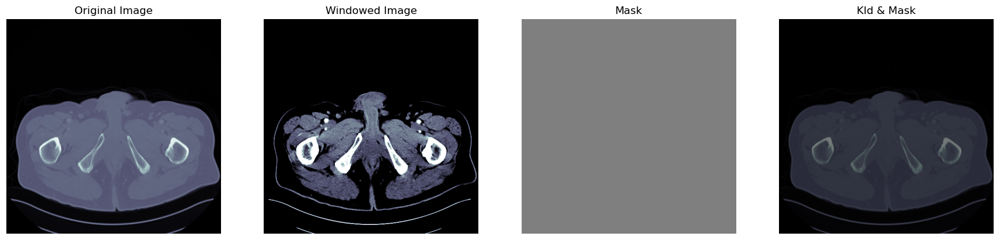

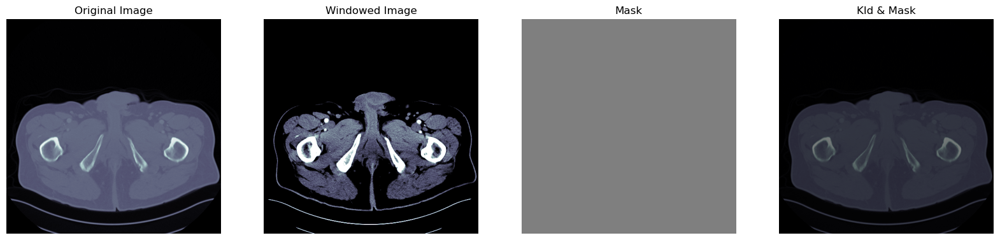

In [25]:
for test_slice_idx in range(0,92):
    plot_sample([vis_im(test_nii[...,test_slice_idx]),vis_im(test_mask[...,test_slice_idx])])

In [26]:
def nii_tfm(fn,wins):
    test_nii=read_nii(fn)
    curr_dim=test_nii.shape[2]
    print(curr_dim)
    slices=[]
    
    for curr_slice in range(curr_dim):
        data=tensor(vis_im(test_nii[...,curr_slice]).astype(np.float32))
        data=(data.to_nchan(wins)*255).byte()
        slices.append(TensorImage(data))
     
    return slices

test_files=nii_tfm(final_df.loc[tst,'dir_in']+"/"+final_df.loc[tst,'fname'],[dicom_windows.liver,dicom_windows.custom])

96


In [27]:
test_dl=learn0.dls.test_dl(test_files)
preds,y=learn0.get_preds(dl=test_dl)

predicted_mask=np.argmax(preds,axis=1)

C:\Users\saich\anaconda3\lib\site-packages\fastai\metrics.py:372: RuntimeWarning: Mean of empty slice
  return np.nanmean(binary_dice_scores)


In [28]:
predicted_mask.shape

torch.Size([96, 512, 512])

In [29]:
def plot_sample_p(array_list,color_map='nipy_spectral'):
    fig=plt.figure(figsize=(20,16),dpi=100)
    
    plt.subplot(1,4,1)
    plt.imshow(array_list[0],cmap='bone')
    plt.title('predicted_image')
    plt.axis('off')
    
    plt.subplot(1,4,2)
    plt.imshow(array_list[1],cmap='bone')
    plt.title('original_image')
    plt.axis('off')

In [31]:
predicted_mask[1].shape

torch.Size([512, 512])

<ipython-input-29-9e2521a22904>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig=plt.figure(figsize=(20,16),dpi=100)


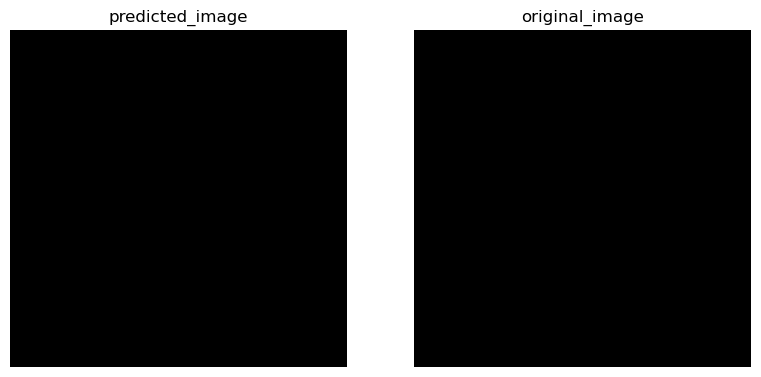

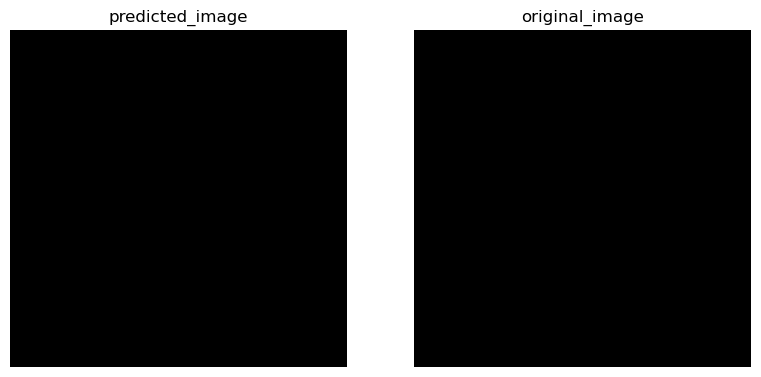

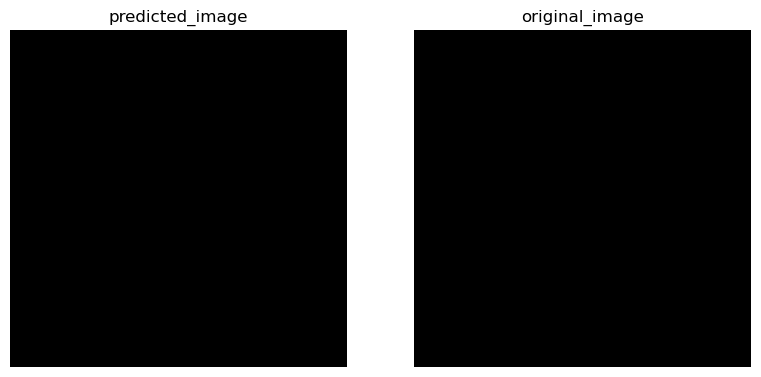

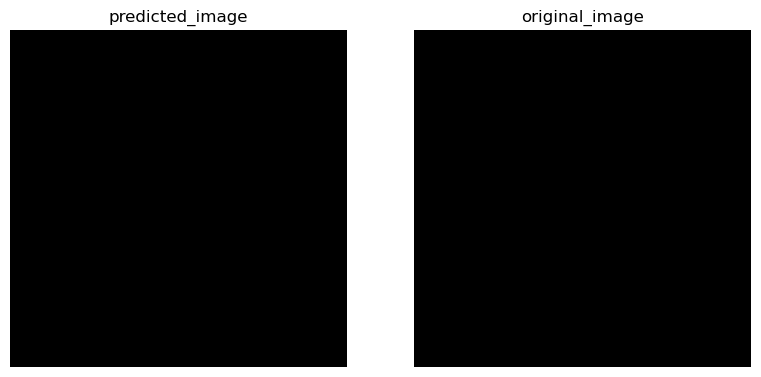

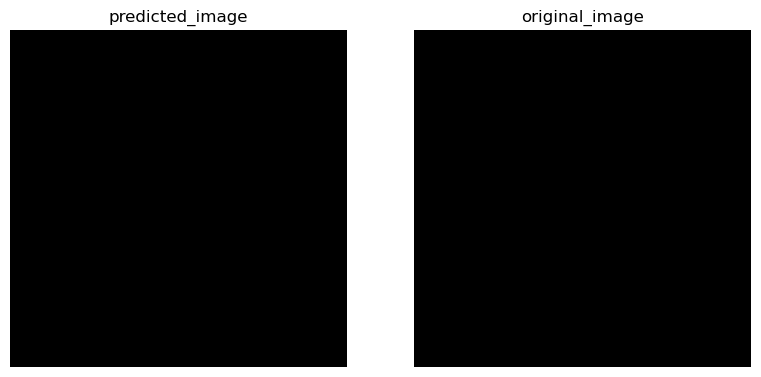

...

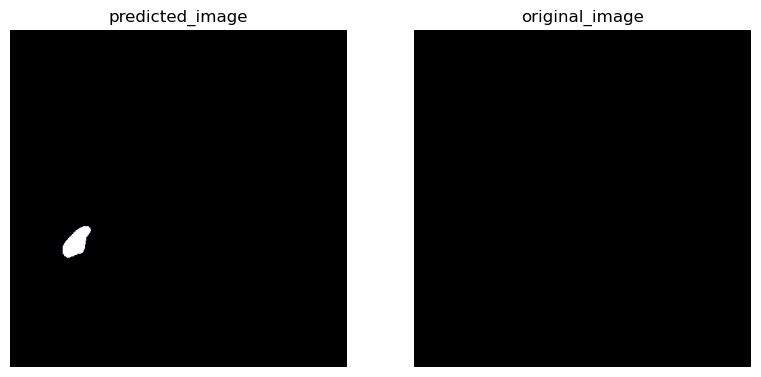

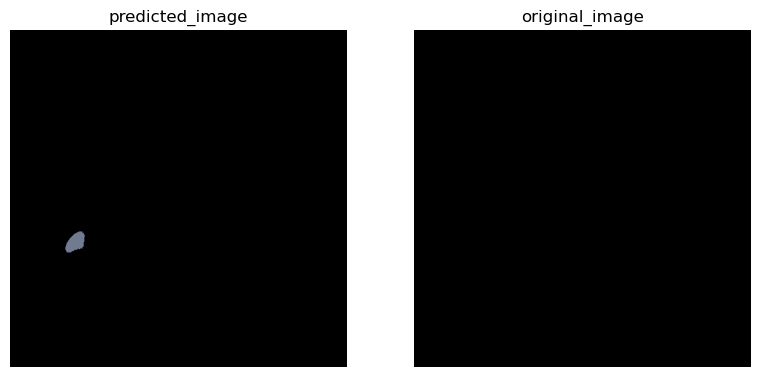

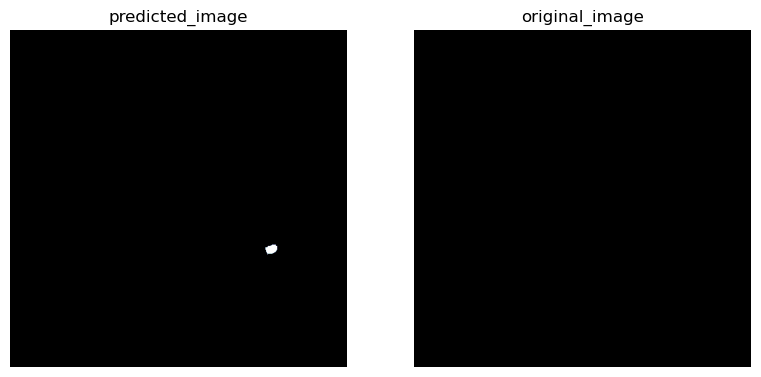

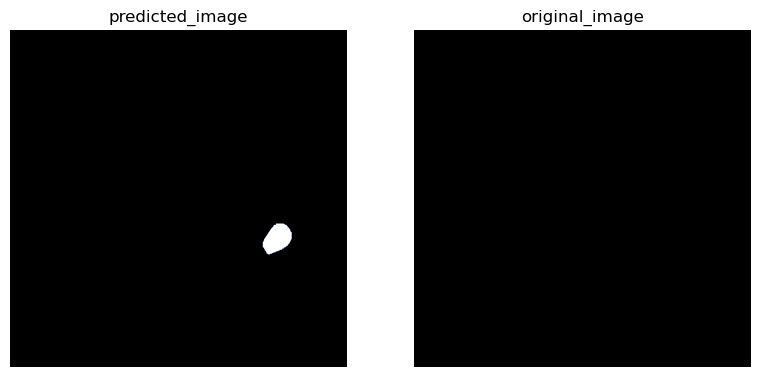

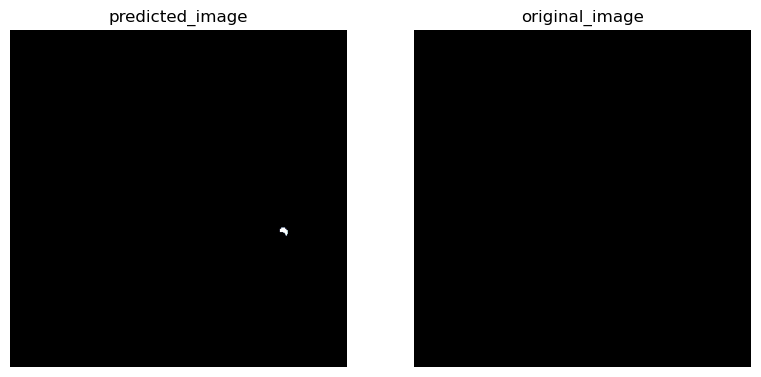

In [32]:
for i in range(0,92):
    plot_sample_p([predicted_mask[i],vis_im(test_mask[...,i])])

In [49]:

dir(learn0)

['T_destination',
 '__call__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__enter__',
 '__eq__',
 '__exit__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__stored_args__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_apply',
 '_backward',
 '_backward_hooks',
 '_bn_bias_state',
 '_buffers',
 '_call_impl',
 '_call_one',
 '_component_attr_filter',
 '_default',
 '_dir',
 '_do_epoch',
 '_do_epoch_train',
 '_do_epoch_validate',
 '_do_fit',
 '_do_one_batch',
 '_end_cleanup',
 '_forward_hooks',
 '_forward_pre_hooks',
 '_get_backward_hooks',
 '_get_name',
 '_grab_cbs',
 '_is_full_backward_hook',
 '_load_from_state_dict',
 '_load_state_dict_post_hooks',
 '_load_state_dict_pre_hooks',
 '_maybe_warn_non_full_backward_h

In [51]:
learn0._metrics

(#1) [<fastai.metrics.DiceMulti object at 0x0000016B98E974C0>]

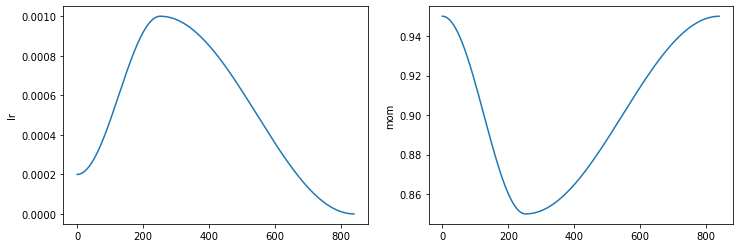

In [58]:
learn0.recorder.plot_sched()

In [63]:
from fastai2.imports import *
from fastai2.torch_core import *
from fastai2.learner import *
    

@delegates(subplots)
def plot_metrics(self: Recorder, nrows=None, ncols=None, figsize=None, **kwargs):
    metrics = np.stack(self.values)
    names = self.metric_names[1:-1]
    n = len(names) - 1
    if nrows is None and ncols is None:
        nrows = int(math.sqrt(n))
        ncols = int(np.ceil(n / nrows))
    elif nrows is None: nrows = int(np.ceil(n / ncols))
    elif ncols is None: ncols = int(np.ceil(n / nrows))
    figsize = figsize or (ncols * 6, nrows * 4)
    fig, axs = subplots(nrows, ncols, figsize=figsize, **kwargs)
    axs = [ax if i < n else ax.set_axis_off() for i, ax in enumerate(axs.flatten())][:n]
    for i, (name, ax) in enumerate(zip(names, [axs[0]] + axs)):
        ax.plot(metrics[:, i], color='#1f77b4' if i == 0 else '#ff7f0e', label='valid' if i > 0 else 'train')
        ax.set_title(name if i > 1 else 'losses')
        ax.legend(loc='best')
    plt.show()

RuntimeError: tensor.H is only supported on matrices (2-D tensors). Got 1-D tensor.

In [66]:
adf = learn0.metrics.
print(adf)

AttributeError: 'list' object has no attribute 'values'

In [61]:
pip install fastai2

  Attempting uninstall: numpy
    Found existing installation: numpy 1.23.1
    Uninstalling numpy-1.23.1:
      Successfully uninstalled numpy-1.23.1
Note: you may need to restart the kernel to use updated packages.
